# Post-scVI analysis of all donors data (nuclei and cells)

After doublets removal (both by genotype and GEX)

This the version of the manifold after running scVI by `sample` and removing genes that have been filtered according to high ambient RNA in notebook **M2**

11.11.2021

What happens here:
- load preprocessed object (raw filtered counts)
- do normalising & log transforming
- save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- calculate neighborhood graph on the latent dimensionality reporesentation from scVI
- umap
- unbiased clustering
- save

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
from glob import iglob
import anndata
import bbknn
import scrublet as scr
import os
import sklearn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

In [2]:
np.random.seed(0)

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.7.5
scanpy      1.7.1
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.5
annoy               NA
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
bbknn               NA
brotli              NA
cairo               1.20.0
certifi             2020.12.05
cffi                1.14.5
chardet             4.0.0
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.03.1
dateutil            2.8.1
decorator           4.4.2
fsspec              0.8.7
get_version         2.1
google              NA
h5py                3.1.0
idna                2.10
igraph              0.8.3
ipykernel           5.5.0
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.3
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_server      1.4.1
jupyte

In [4]:
save_path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202111_MFI_sc_sn_new_scVI_analysis/'

## Reading the preprocessed object

Preprocessing happened in M0 notebook

In [5]:
# reading the raw filtered object from joint analysis
adata = sc.read(save_path + 'adata_raw_filtered.h5ad')

In [6]:
# reading IDs of final cells to keep after doublet exclusion (scrublet and souporcell)
nodoublet_IDs = pd.read_csv(save_path + 'selected_droplets_no_doublets_in_M1_prelim_analysis.csv', index_col=0)
nodoublet_IDs

/opt/conda/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,n_genes,sample,technology,tissue,dev_age,donor,dataset,run,number_of_individuals_multiplexed,batch,...,probabilities,barcode_sample_copy,souporcell_assignment,inter_ind_doublet,S_score,G2M_score,phase,origin_M_F,is_doublet_0.05,is_doublet_0.01
barcode_sample,,,,,,,,,,,,,,,,,,,,,
AAACGGGCATTGGCGC-1_FCA7167219,1941,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAACGGGCATTGGCGC-1_FCA7167219,FCA7167219_0,0,-0.022318,-0.029351,G1,M,0,0
AAACGGGTCGCGATCG-1_FCA7167219,1246,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAACGGGTCGCGATCG-1_FCA7167219,FCA7167219_0,0,0.109294,-0.048533,S,M,0,0
AAAGATGAGCAATATG-1_FCA7167219,1516,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,0.999998,AAAGATGAGCAATATG-1_FCA7167219,FCA7167219_0,0,-0.045822,-0.097222,G1,M,0,0
AAAGATGAGTTCGCGC-1_FCA7167219,2099,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAAGATGAGTTCGCGC-1_FCA7167219,FCA7167219_0,0,-0.033310,-0.112754,G1,M,0,0
AAAGATGCATGTCGAT-1_FCA7167219,1636,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAAGATGCATGTCGAT-1_FCA7167219,FCA7167219_0,0,0.033493,-0.107313,S,M,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTGTTCGTCAAGT-1_Pla_Camb10714920,2409,Pla_Camb10714920,10X_multiome,decidua_placenta_myometrium,8-9_PCW,P13,Ashley_collection_sn,NaN,1,61,...,0.957605,TTTGTGTTCGTCAAGT-1_Pla_Camb10714920,Pla_Camb10714920_0,0,0.008248,-0.176324,S,M,0,0
TTTGTGTTCTTAGTCT-1_Pla_Camb10714920,4129,Pla_Camb10714920,10X_multiome,decidua_placenta_myometrium,8-9_PCW,P13,Ashley_collection_sn,NaN,1,61,...,1.000000,TTTGTGTTCTTAGTCT-1_Pla_Camb10714920,Pla_Camb10714920_1,0,-0.073279,-0.153125,G1,F,0,0
TTTGTTGGTCACAGCG-1_Pla_Camb10714920,3116,Pla_Camb10714920,10X_multiome,decidua_placenta_myometrium,8-9_PCW,P13,Ashley_collection_sn,NaN,1,61,...,0.989358,TTTGTTGGTCACAGCG-1_Pla_Camb10714920,Pla_Camb10714920_1,0,-0.010057,-0.110007,G1,F,0,0


In [7]:
# subsetting the adata object to final cells
adata = adata[list(nodoublet_IDs.index), :].copy()
adata

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


AnnData object with n_obs × n_vars = 378558 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 'n_cells-18', 'gene_ids-19', 'feature_types-1

In [8]:
# adding metadata
for col in nodoublet_IDs.columns:
    print(col)
    adata.obs[col] = nodoublet_IDs.loc[adata.obs_names,col]

n_genes
sample
technology
tissue
dev_age
donor
dataset
run
number_of_individuals_multiplexed
batch
percent_mito
n_counts
scrublet_score
scrublet_cluster_score
bh_pval
is_doublet
celltype_predictions
probabilities
barcode_sample_copy
souporcell_assignment
inter_ind_doublet
S_score
G2M_score
phase
origin_M_F
is_doublet_0.05
is_doublet_0.01


In [9]:
np.unique(adata.obs['sample'])

array(['FCA7167219', 'FCA7167221', 'FCA7167222', 'FCA7167223',
       'FCA7167224', 'FCA7167226', 'FCA7167230', 'FCA7167231',
       'FCA7167232', 'FCA7196218', 'FCA7196219', 'FCA7196220',
       'FCA7196224', 'FCA7196225', 'FCA7196226', 'FCA7196229',
       'FCA7196231', 'FCA7474062', 'FCA7474063', 'FCA7474064',
       'FCA7474065', 'FCA7474066', 'FCA7474068', 'FCA7474069',
       'FCA7511881', 'FCA7511882', 'FCA7511883', 'FCA7511884',
       'FCA7511885', 'FCA7511886', 'Pla_Camb10691970', 'Pla_Camb10691971',
       'Pla_Camb10691972', 'Pla_Camb10691975', 'Pla_Camb10714918',
       'Pla_Camb10714919', 'Pla_Camb10714920', 'Pla_HDBR10142767',
       'Pla_HDBR10142768', 'Pla_HDBR10142769', 'Pla_HDBR10142770',
       'Pla_HDBR10142863', 'Pla_HDBR10142864', 'Pla_HDBR10142865',
       'Pla_HDBR10701666', 'Pla_HDBR10701667', 'Pla_HDBR10701668',
       'Pla_HDBR10917730', 'Pla_HDBR10917731', 'Pla_HDBR10917733',
       'Pla_HDBR8624430', 'Pla_HDBR8624431', 'Pla_HDBR8715512',
       'Pla_HDBR87

In [10]:
# quick check to see if raw is raw or not
expr_mtx_dense = adata[adata.obs['sample'] == 'Pla_Camb10691970'].X.todense()

In [11]:
# YAS we all good
np.unique(expr_mtx_dense)

matrix([[   0.,    0.,    0., ..., 4162., 4637., 6366.]], dtype=float32)

________

Carrying on to 
- Normalise and log transform
- Save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- Make cell names (obs) and gene names (var) unique

In [12]:
# normalise and log transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

# saving normalised and log transformed values into the raw attribute to later be able to plot
adata.raw = adata.copy()

adata.var_names_make_unique()
adata.obs_names_make_unique()

normalizing by total count per cell
    finished (0:00:14): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


_____________________________________________________________________________________________________________________________________________________________

In [13]:
# Assign cell cycle stage & scores
cell_cycle_genes = [x.strip() for x in open(file='/home/jovyan/notebooks/Vento_Lab/regev_lab_cell_cycle_genes_from_Luz_20200505.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
s_genes = [x for x in s_genes if x in adata.var_names]
g2m_genes = [x for x in g2m_genes if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    503 total control genes are used. (0:00:12)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    504 total control genes are used. (0:00:12)
-->     'phase', cell cycle phase (adata.obs)


In [14]:
adata

AnnData object with n_obs × n_vars = 378558 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'featur

_______________________________________________________________________________________________________

# Read in scVI-calculated latent representation

In [18]:
# in this case we only used 16 PCs, but also experimented with the layers
n_latent = [16]
n_layers = [1,2,3]

### 11.11.2021 run, correction by `sample`

In [21]:
latent_representations = {}

for n_layers_value in n_layers:
    print(n_layers_value)
    
    curr_path = '/nfs/team292/aa22/scVI_related/202111_upd_in_vivo_analysis/all_donors_analysis/results/20211111_obsm_with_scVI_latent_representation_n_16_after_CCG_removal_and_all_doublet_exclusion_by_sample_all_cells_and_nuclei_with_LF_gene_filter_n_layers_' + str(n_layers_value) + '.csv' 
        
    latent_representations[n_layers_value] = pd.read_csv(curr_path, index_col=0)

1
2
3


In [25]:
# assign these latent_representations into adata.obsm
for n_layers_value in n_layers:
    print(n_layers_value)
    adata.obsm['X_scVI_n_latent_16_sample_n_layers_' + str(n_layers_value) + '_gf'] = np.array(latent_representations[n_layers_value])

1
2
3


In [27]:
adata.obsm['X_scVI_n_latent_16_sample_n_layers_1_gf'].shape

(378558, 16)

__________________________________________________________________________________________________________________________________________________________________

### Neighbourhood graph & UMAP

In [28]:
%%time

for n_layers_value in n_layers:
    print(n_layers_value)
    sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_scVI_n_latent_16_sample_n_layers_' + str(n_layers_value) + '_gf',
               key_added='neighbors_scVI_n_latent_16_sample_n_layers_' + str(n_layers_value) + '_gf')

computing neighbors


1


    finished: added to `.uns['neighbors_scVI_n_latent_16_sample_n_layers_1_gf']`
    `.obsp['neighbors_scVI_n_latent_16_sample_n_layers_1_gf_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_16_sample_n_layers_1_gf_connectivities']`, weighted adjacency matrix (0:01:03)
computing neighbors


2


    finished: added to `.uns['neighbors_scVI_n_latent_16_sample_n_layers_2_gf']`
    `.obsp['neighbors_scVI_n_latent_16_sample_n_layers_2_gf_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_16_sample_n_layers_2_gf_connectivities']`, weighted adjacency matrix (0:00:51)
computing neighbors


3


    finished: added to `.uns['neighbors_scVI_n_latent_16_sample_n_layers_3_gf']`
    `.obsp['neighbors_scVI_n_latent_16_sample_n_layers_3_gf_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_16_sample_n_layers_3_gf_connectivities']`, weighted adjacency matrix (0:00:55)


CPU times: user 4min 59s, sys: 15min 54s, total: 20min 53s
Wall time: 2min 50s


In [29]:
adata

AnnData object with n_obs × n_vars = 378558 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'featur

__________________________________________________________________________________________________________________________________________________________________

In [30]:
%%time
# takes about 20 minutes
for n_layers_value in n_layers:
    print(n_layers_value)
    
    sc.tl.umap(adata, random_state=0,
              neighbors_key='neighbors_scVI_n_latent_16_sample_n_layers_' + str(n_layers_value) + '_gf')
    # copy current adata.obsm['X_umap'] into adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value)]
    adata.obsm['X_umap_scVI_n_latent_16_sample_n_layers_' + str(n_layers_value) + '_gf'] = adata.obsm['X_umap']
    
    

computing UMAP


1


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:16)
computing UMAP


2


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:17)
computing UMAP


3


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:06:07)


CPU times: user 1h 42min 41s, sys: 32min 32s, total: 2h 15min 13s
Wall time: 18min 41s


In [31]:
np.unique(adata.obs['sample'], return_counts=True)

(array(['FCA7167219', 'FCA7167221', 'FCA7167222', 'FCA7167223',
        'FCA7167224', 'FCA7167226', 'FCA7167230', 'FCA7167231',
        'FCA7167232', 'FCA7196218', 'FCA7196219', 'FCA7196220',
        'FCA7196224', 'FCA7196225', 'FCA7196226', 'FCA7196229',
        'FCA7196231', 'FCA7474062', 'FCA7474063', 'FCA7474064',
        'FCA7474065', 'FCA7474066', 'FCA7474068', 'FCA7474069',
        'FCA7511881', 'FCA7511882', 'FCA7511883', 'FCA7511884',
        'FCA7511885', 'FCA7511886', 'Pla_Camb10691970', 'Pla_Camb10691971',
        'Pla_Camb10691972', 'Pla_Camb10691975', 'Pla_Camb10714918',
        'Pla_Camb10714919', 'Pla_Camb10714920', 'Pla_HDBR10142767',
        'Pla_HDBR10142768', 'Pla_HDBR10142769', 'Pla_HDBR10142770',
        'Pla_HDBR10142863', 'Pla_HDBR10142864', 'Pla_HDBR10142865',
        'Pla_HDBR10701666', 'Pla_HDBR10701667', 'Pla_HDBR10701668',
        'Pla_HDBR10917730', 'Pla_HDBR10917731', 'Pla_HDBR10917733',
        'Pla_HDBR8624430', 'Pla_HDBR8624431', 'Pla_HDBR8715512',
   

In [32]:
adata

AnnData object with n_obs × n_vars = 378558 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'featur

## Saving this object with all the manifolds calculated

In [33]:
adata.write(save_path + 'adata_scVI_analysed_corr_by_sample_all_cells_and_nuclei_v1a_with_LF_gene_filter.h5ad')


... storing 'sample' as categorical
... storing 'technology' as categorical
... storing 'tissue' as categorical
... storing 'dev_age' as categorical
... storing 'donor' as categorical
... storing 'dataset' as categorical
... storing 'celltype_predictions' as categorical
... storing 'souporcell_assignment' as categorical
... storing 'phase' as categorical
... storing 'origin_M_F' as categorical


In [ ]:
# reading the previously saved file
adata = sc.read(save_path + 'adata_scVI_analysed_corr_by_sample_all_cells_and_nuclei_v1a_with_LF_gene_filter.h5ad')


In [6]:
# to better distinguish predictions from Vento-Tormo dataset
colors_VT = ['#C1B4A7','#E8D6E0','#40ab5d','#F4BF73','#F7B5A4',
                 '#d8e7a4','#2ECCFA','#39728C','#FA5858','#E9A1C7',
                 '#B40486','#004529','#C49A6C','#9255a0', '#58595B', '#A3A8AD',
                 '#F6D8CE','#633A6D','#C7E0BD','#49ABC8', '#E7C949', '#F7F297', '#af9e56',
                 '#ED1B64','#E59C24','#C2E8F6','#677EB2','#73FDD6', '#BC3122', '#771A15',
                 '#E6C6F7','#CEE3F6','#CECEF6','#677EB2','#6363A5','#63A585',
                 '#246D66','#9B8579']

### scVI-corrected by `sample`

n_latent = 16, n_layers = 1

In [35]:
curr_embedding_key = 'X_umap_scVI_n_latent_16_sample_n_layers_1_gf'

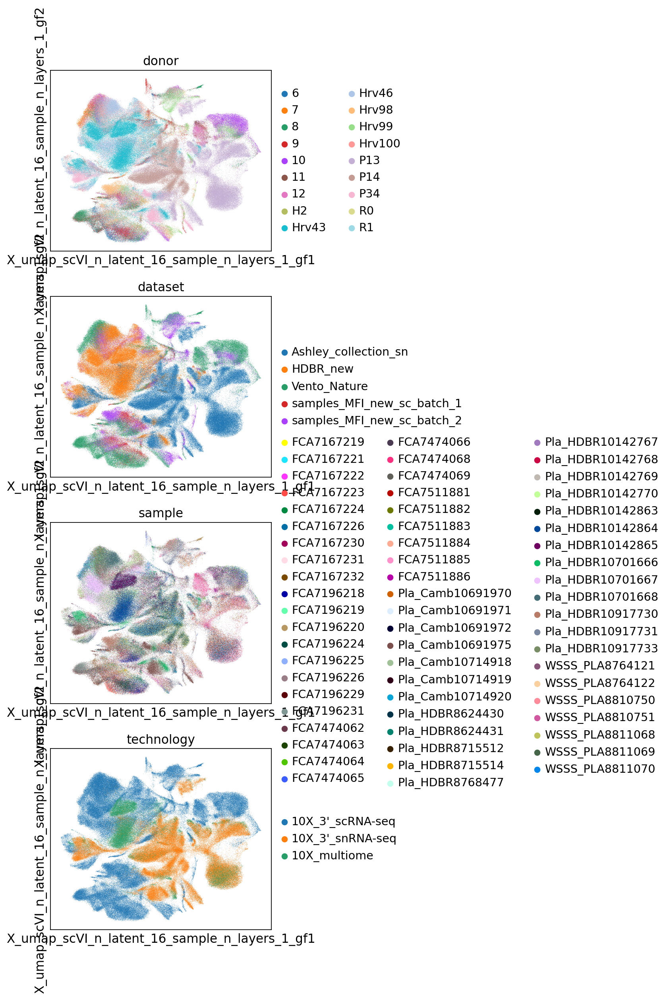

In [36]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','sample','technology'], ncols=1)

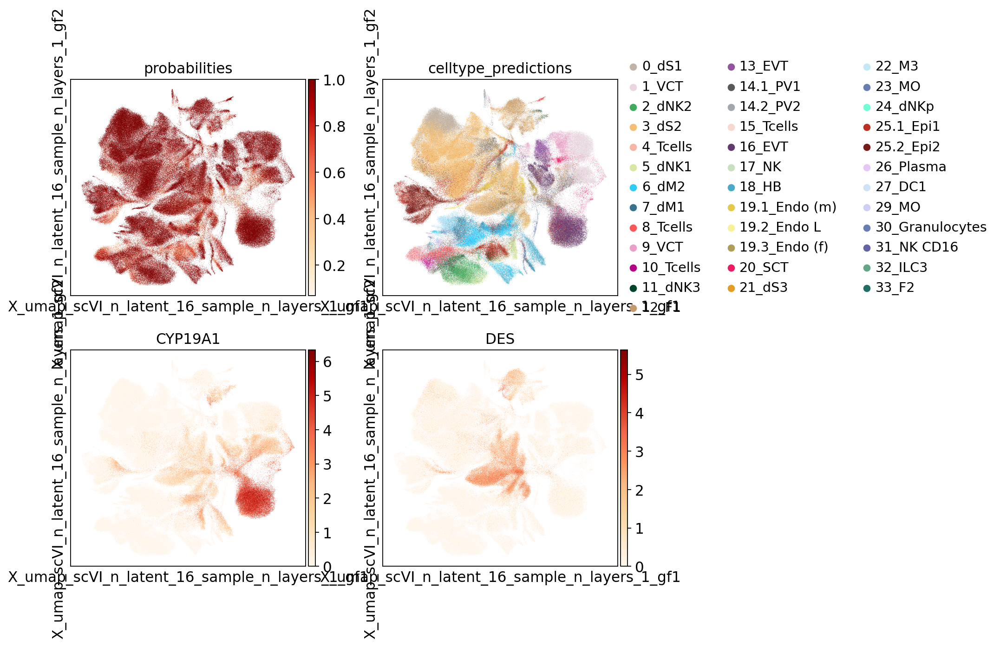

In [37]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['probabilities','celltype_predictions','CYP19A1','DES'], cmap='OrRd', ncols=2,
               palette=colors_VT)

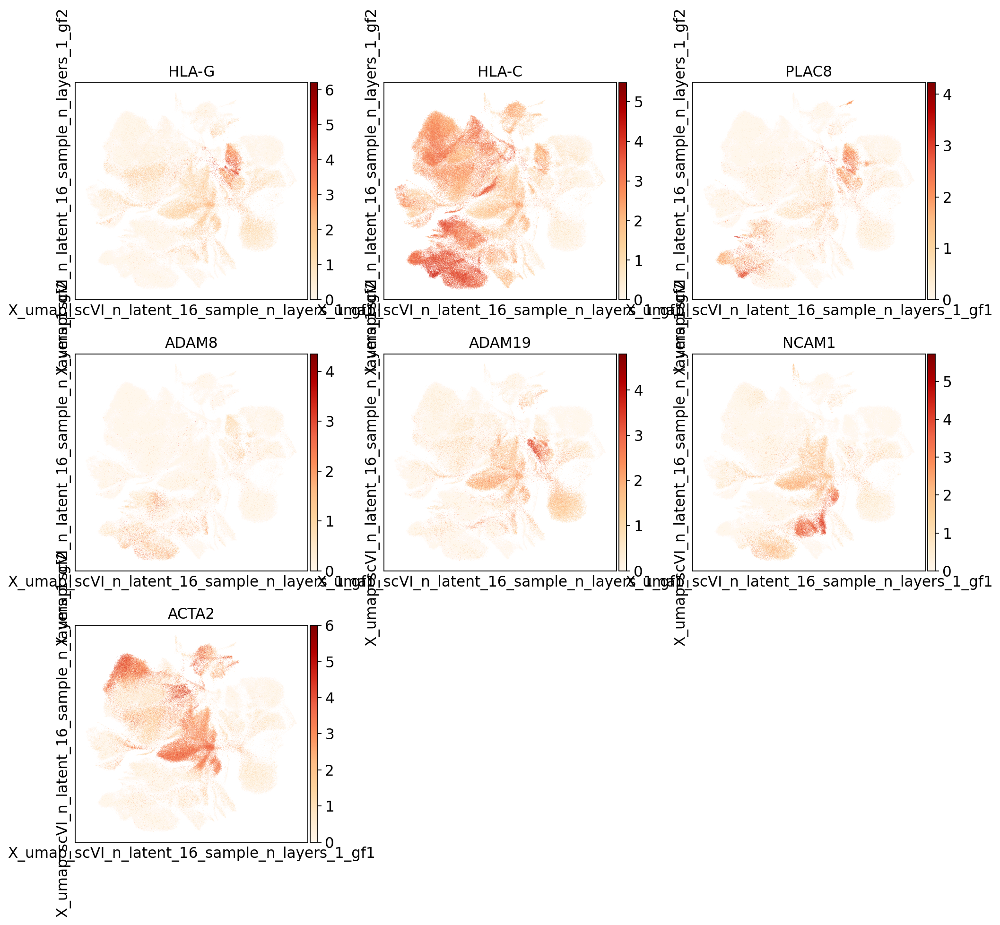

In [38]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

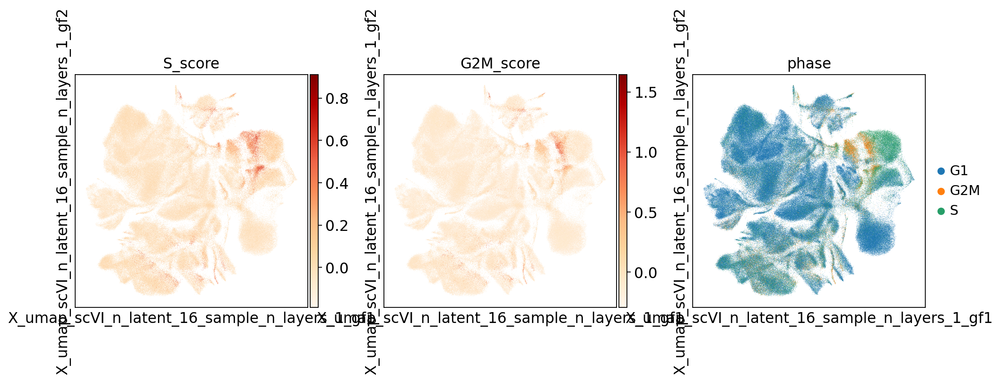

In [39]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [40]:
adata

AnnData object with n_obs × n_vars = 378558 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'featur

### scVI-corrected by `sample`

n_latent = 16, n_layers = 2

In [41]:
curr_embedding_key = 'X_umap_scVI_n_latent_16_sample_n_layers_2_gf'

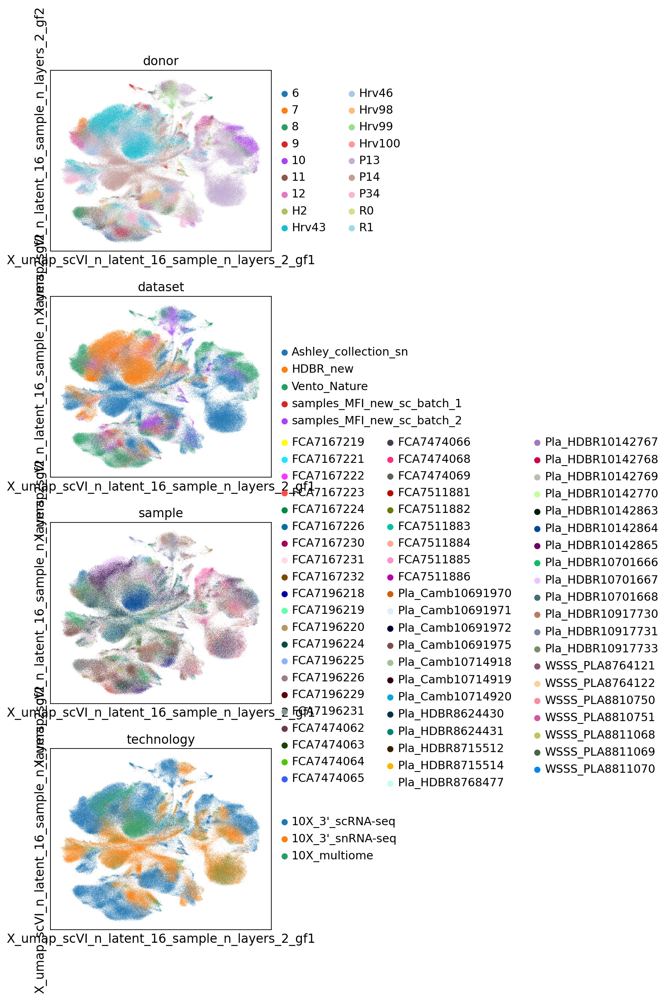

In [42]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','sample','technology'], ncols=1)

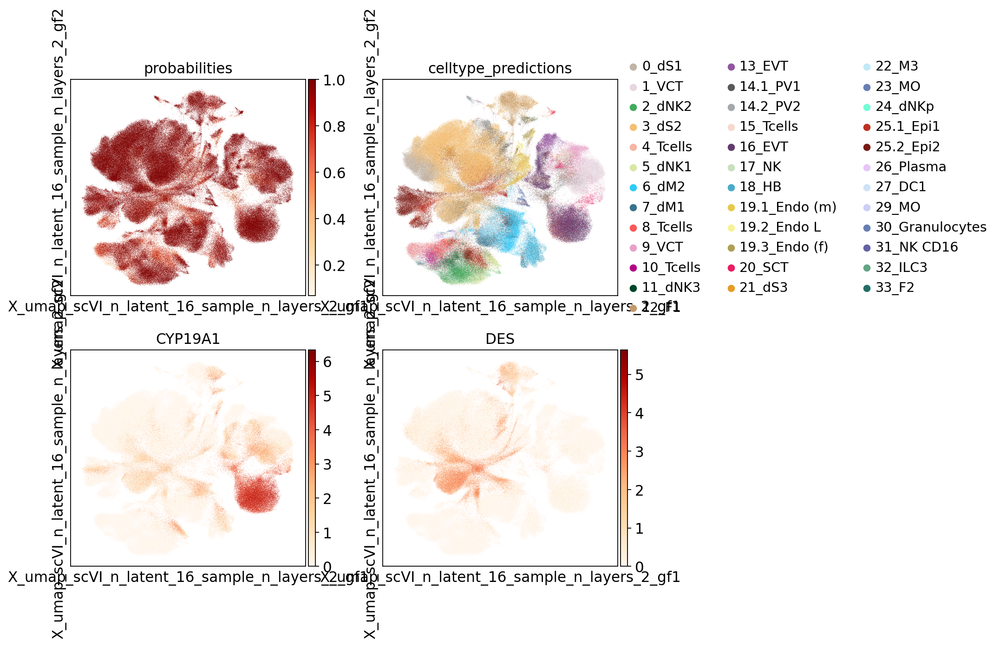

In [43]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['probabilities','celltype_predictions','CYP19A1','DES'], cmap='OrRd', ncols=2,
               palette=colors_VT)

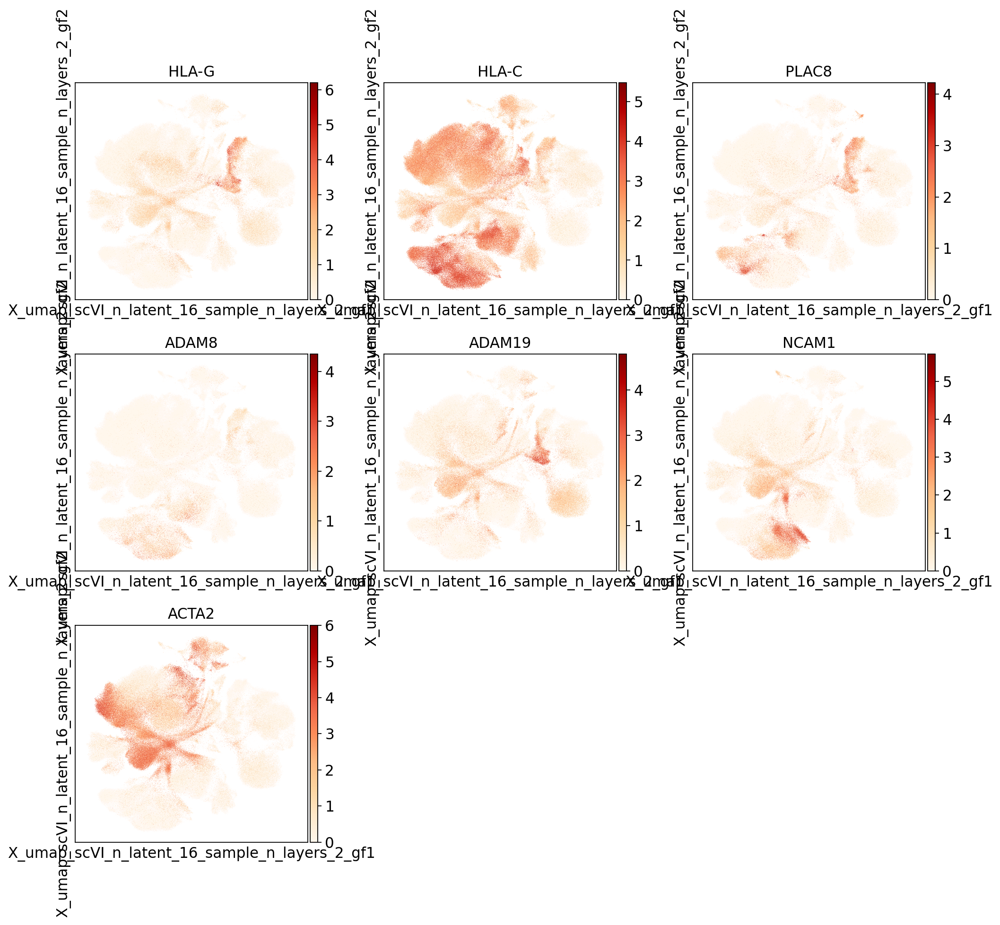

In [44]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

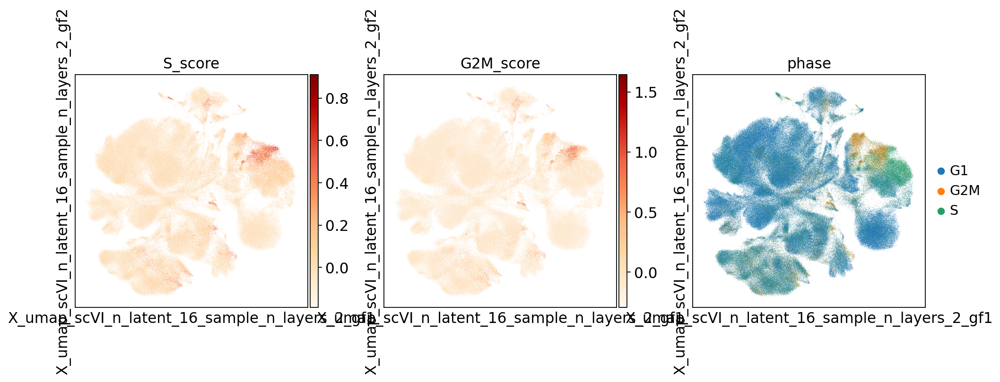

In [45]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [46]:
adata

AnnData object with n_obs × n_vars = 378558 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'featur

### scVI-corrected by `sample`

n_latent = 16, n_layers = 3

In [7]:
curr_embedding_key = 'X_umap_scVI_n_latent_16_sample_n_layers_3_gf'

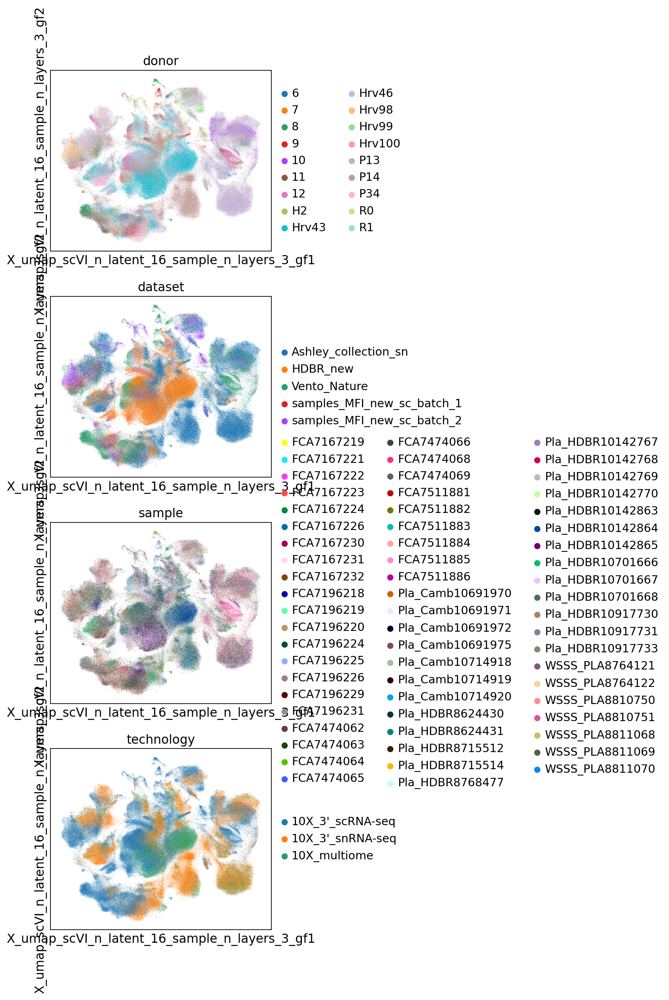

In [48]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','sample','technology'], ncols=1)

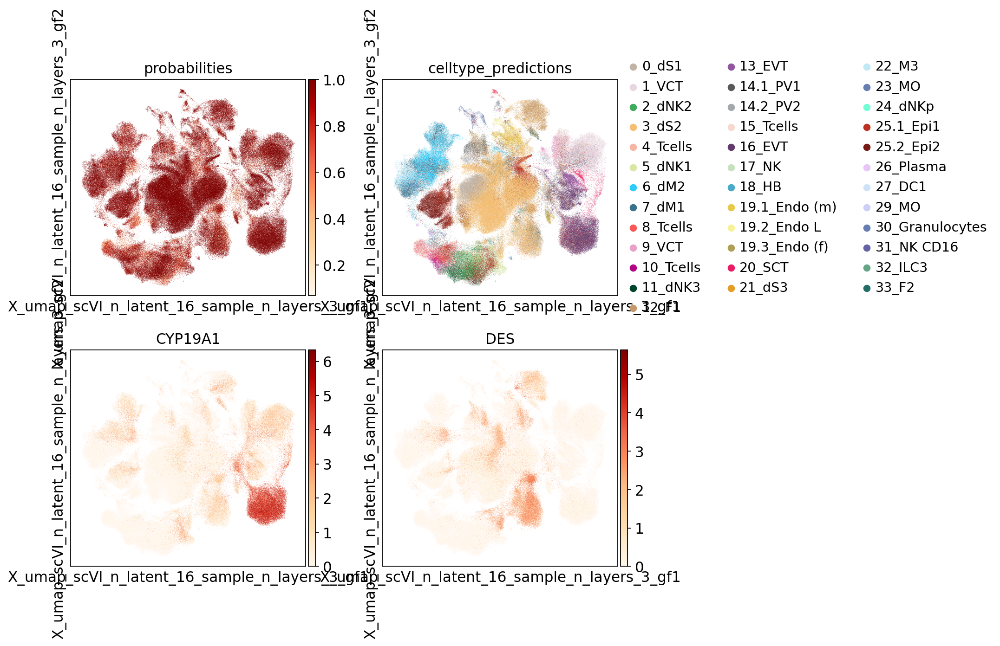

In [64]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['probabilities','celltype_predictions','CYP19A1','DES'], cmap='OrRd', ncols=2,
               palette=colors_VT)

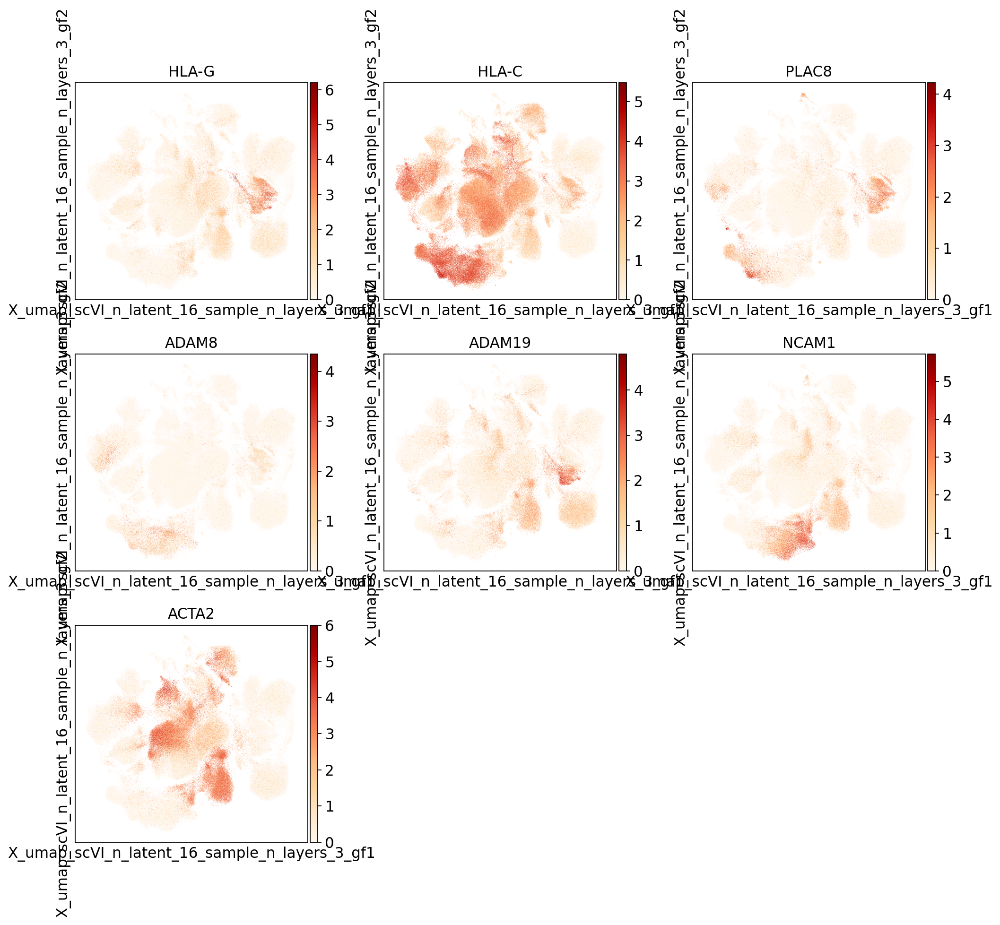

In [65]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

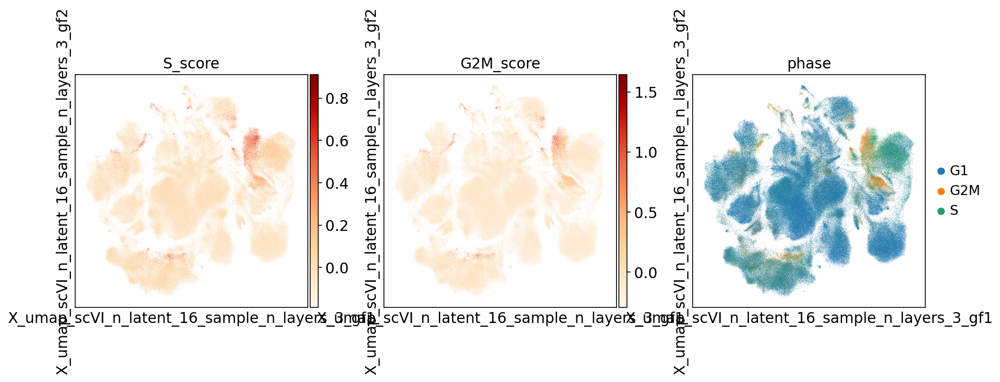

In [66]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [67]:
adata

AnnData object with n_obs × n_vars = 378558 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'annotations_P13_troph'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15

In [8]:
# reading in adata with annotations of donor P13 troph (SN+multiome, updated) to see where they fall on this manifold - to kind of "back up" the clustering of the trophoblast
adata_P13_troph = sc.read('/lustre/scratch117/cellgen/team292/aa22/adata_objects/202007_snRNA-seq_MFI/snRNA_seq_MFI_202007_adatas/202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants/donor_P13_all_samples_analysis_202110/adata_P13_scVI_analysed_corr_by_sample_SN_and_multiome_trophoblast_v5_final.h5ad',)

In [9]:
adata_P13_troph

AnnData object with n_obs × n_vars = 37675 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 

In [10]:
len(set(adata.obs_names) & set(adata_P13_troph.obs_names))

31497

In [11]:
# takes a few minutes?

adata.obs['annotations_P13_troph'] = ['NA']*len(adata)

droplet_IDs = list(set(adata.obs_names) & set(adata_P13_troph.obs_names))

adata.obs.loc[droplet_IDs,'annotations_P13_troph'] = adata_P13_troph.obs.loc[droplet_IDs,'final_annot_all_troph']    

In [12]:
adata.obs['annotations_P13_troph'].value_counts()

NA            347061
SCT            18471
VCT             6944
VCT_p           1761
iEVT            1464
VCT_CCC          846
EVT_2            767
EVT_1            601
VCT_fusing       487
GC                94
eEVT              62
Name: annotations_P13_troph, dtype: int64

... storing 'annotations_P13_troph' as categorical


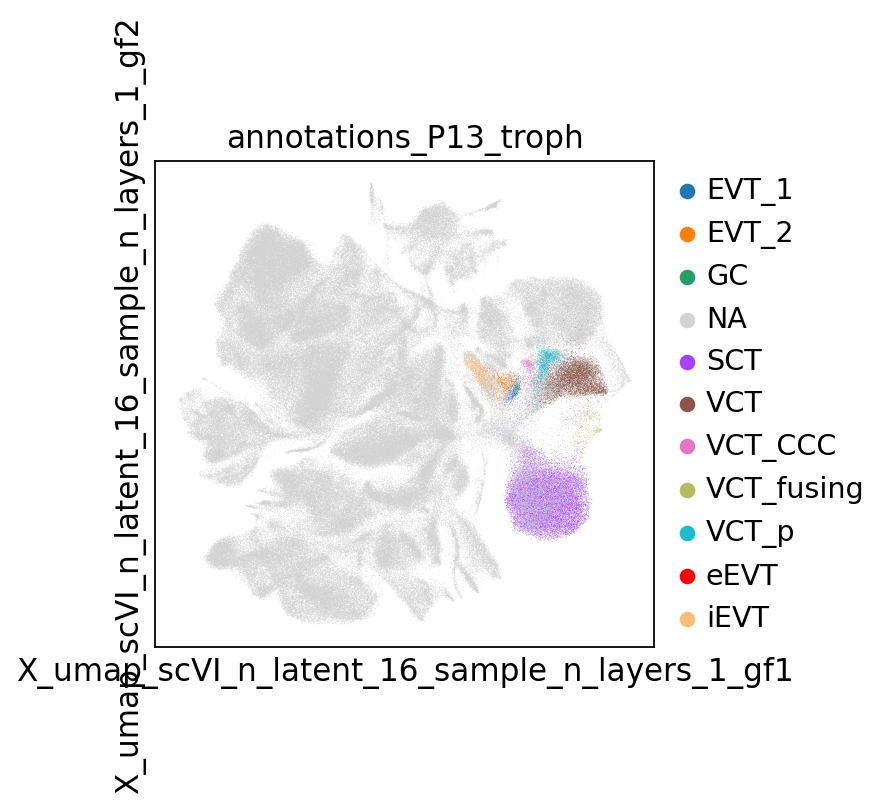

In [56]:
sc.pl.embedding(adata, 'X_umap_scVI_n_latent_16_sample_n_layers_1_gf',
                color=['annotations_P13_troph'], palette = ['#1f77b4',
                                                         '#ff7f0e',
                                                         '#279e68',
                                                         'lightgrey',
                                                         '#aa40fc',
                                                         '#8c564b',
                                                         '#e377c2',
                                                         '#b5bd61',
                                                         '#17becf',
                                                         'red',
                                                         '#ffbb78'])

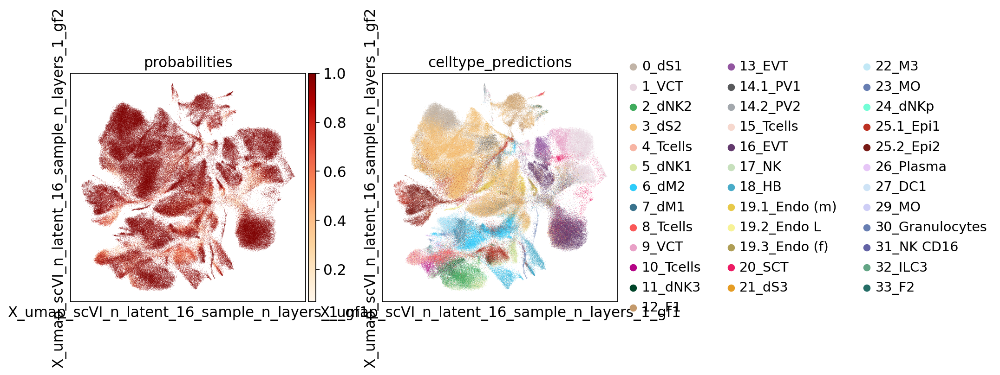

In [57]:
sc.pl.embedding(adata, 'X_umap_scVI_n_latent_16_sample_n_layers_1_gf',
                color=['probabilities','celltype_predictions'], cmap='OrRd', ncols=2,
               palette=colors_VT)

In [58]:
adata

AnnData object with n_obs × n_vars = 378558 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'annotations_P13_troph'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15

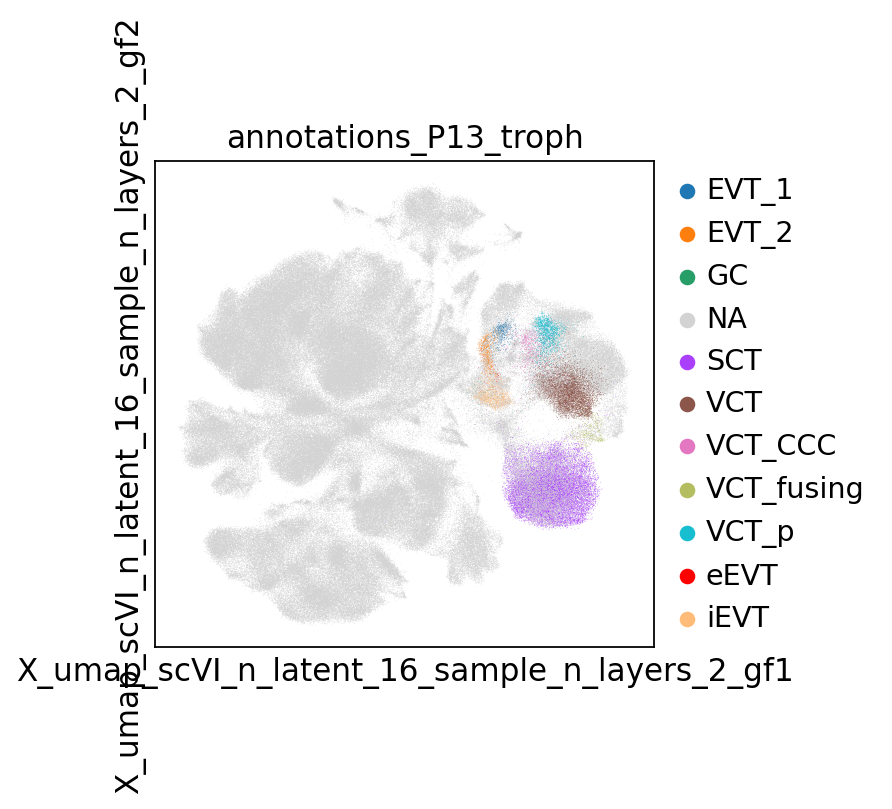

In [59]:
sc.pl.embedding(adata, 'X_umap_scVI_n_latent_16_sample_n_layers_2_gf',
                color=['annotations_P13_troph'], palette = ['#1f77b4',
                                                         '#ff7f0e',
                                                         '#279e68',
                                                         'lightgrey',
                                                         '#aa40fc',
                                                         '#8c564b',
                                                         '#e377c2',
                                                         '#b5bd61',
                                                         '#17becf',
                                                         'red',
                                                         '#ffbb78'])

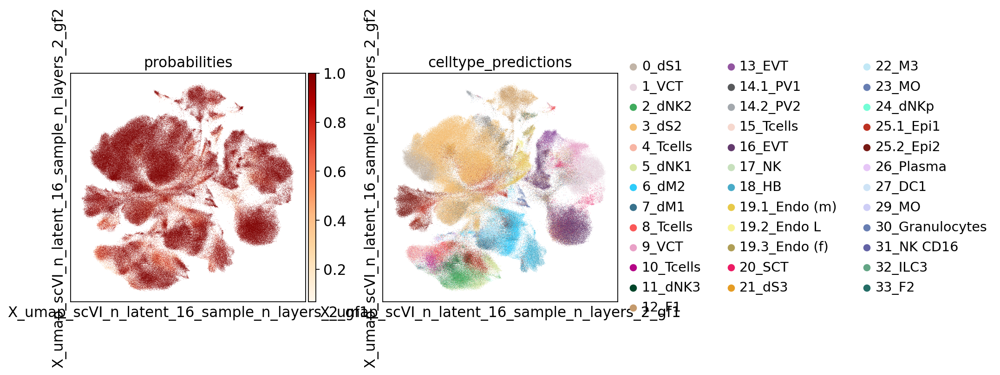

In [60]:
sc.pl.embedding(adata, 'X_umap_scVI_n_latent_16_sample_n_layers_2_gf',
                color=['probabilities','celltype_predictions'], cmap='OrRd', ncols=2,
               palette=colors_VT)

... storing 'annotations_P13_troph' as categorical


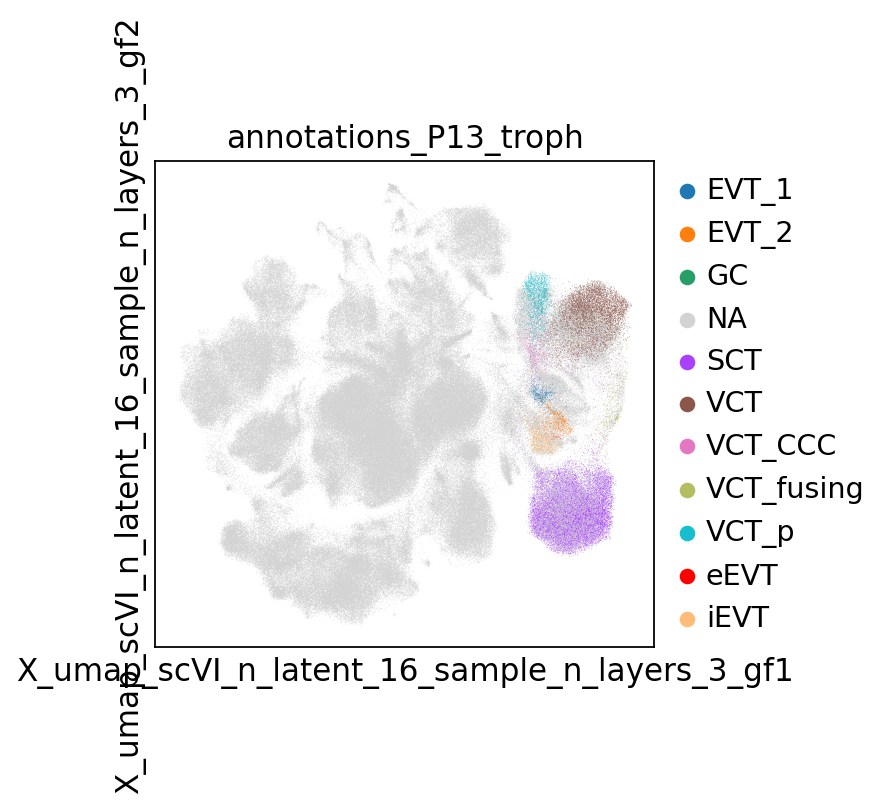

In [13]:
sc.pl.embedding(adata, 'X_umap_scVI_n_latent_16_sample_n_layers_3_gf',
                color=['annotations_P13_troph'], palette = ['#1f77b4',
                                                         '#ff7f0e',
                                                         '#279e68',
                                                         'lightgrey',
                                                         '#aa40fc',
                                                         '#8c564b',
                                                         '#e377c2',
                                                         '#b5bd61',
                                                         '#17becf',
                                                         'red',
                                                         '#ffbb78'])

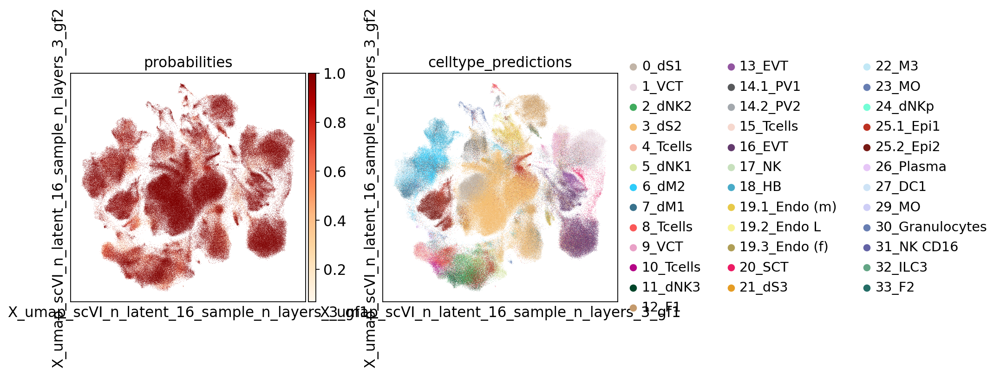

In [14]:
sc.pl.embedding(adata, 'X_umap_scVI_n_latent_16_sample_n_layers_3_gf',
                color=['probabilities','celltype_predictions'], cmap='OrRd', ncols=2,
               palette=colors_VT)

### Let's cluster apart the presumable troph compartment and other coarse compartments in the version of the object with n_layers = 3 and see the contents donor and technology wise


In [15]:
curr_embedding_key = 'X_umap_scVI_n_latent_16_sample_n_layers_3_gf'

In [16]:
sc.tl.louvain(adata, resolution=1.0,
             neighbors_key = 'neighbors_scVI_n_latent_16_sample_n_layers_3_gf',
             key_added = 'louvain_scVI_n_latent_16_sample_n_layers_3_gf')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 28 clusters and added
    'louvain_scVI_n_latent_16_sample_n_layers_3_gf', the cluster labels (adata.obs, categorical) (0:03:09)


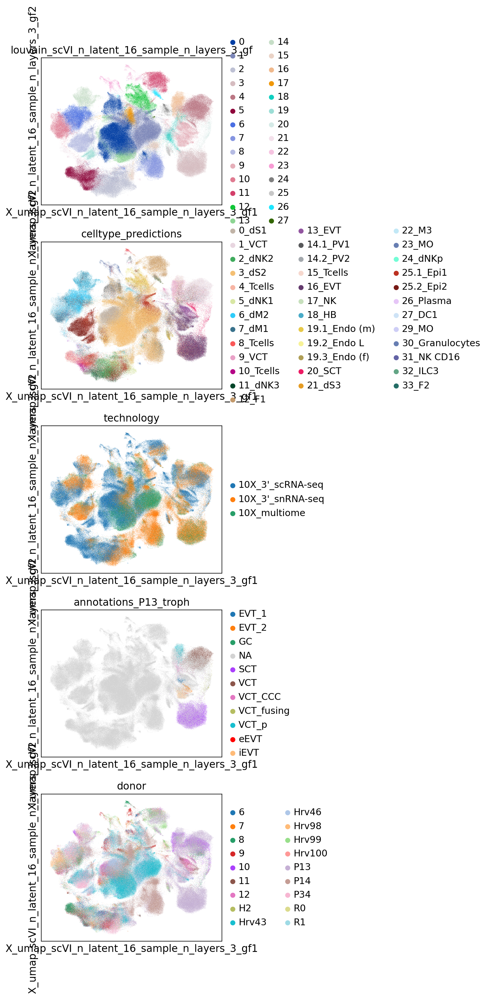

In [17]:
sc.pl.embedding(adata, curr_embedding_key, color=['louvain_scVI_n_latent_16_sample_n_layers_3_gf',
                                                 'celltype_predictions','technology','annotations_P13_troph','donor'],
               ncols=1
               )

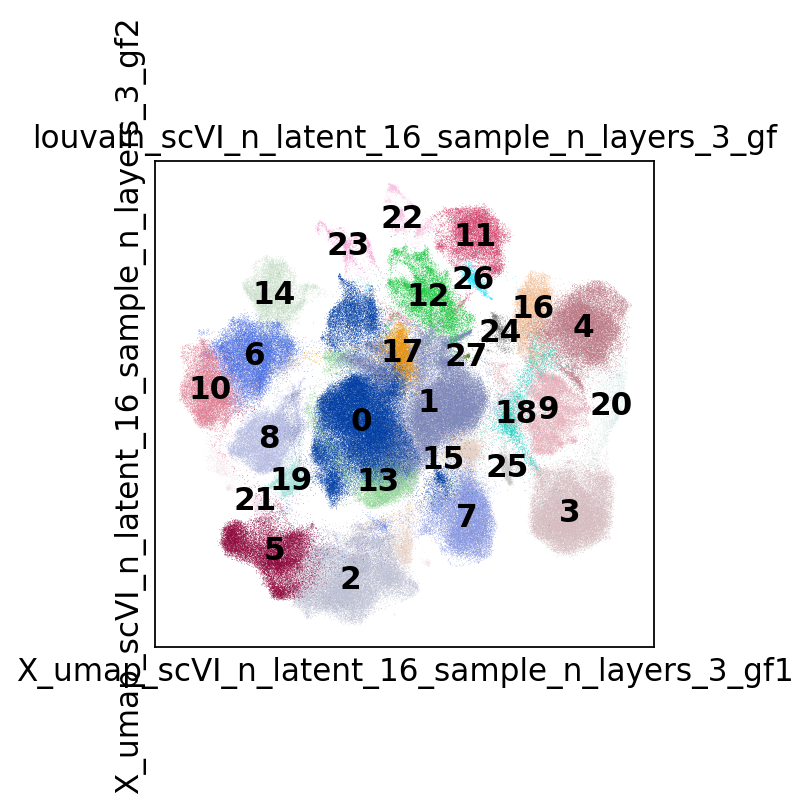

In [18]:
sc.pl.embedding(adata, curr_embedding_key, color=['louvain_scVI_n_latent_16_sample_n_layers_3_gf',
                                                 #'celltype_predictions','annotations_P13_troph','donor','technology'
                                                 ], legend_loc='on data',
               ncols=1
               )

In [21]:
for clus in ['3','4','9','16','18','20','24','25']: #np.unique(adata.obs['louvain_scVI_n_latent_16_sample_n_layers_3_gf']):
    print(clus)
    curr_adata = adata[adata.obs['louvain_scVI_n_latent_16_sample_n_layers_3_gf'] == clus]
    
    print(curr_adata.obs['celltype_predictions'].value_counts(), '\n')

3
16_EVT             23683
3_dS2               2472
20_SCT              2156
1_VCT                328
12_F1                143
7_dM1                119
22_M3                 20
13_EVT                 9
18_HB                  8
2_dNK2                 8
17_NK                  6
30_Granulocytes        5
8_Tcells               3
6_dM2                  3
5_dNK1                 2
25.1_Epi1              2
25.2_Epi2              2
14.2_PV2               2
Name: celltype_predictions, dtype: int64 

4
1_VCT              18585
20_SCT              1412
9_VCT               1346
7_dM1                654
12_F1                567
16_EVT               440
3_dS2                421
25.1_Epi1             86
17_NK                 59
25.2_Epi2             48
18_HB                 28
5_dNK1                25
30_Granulocytes       17
13_EVT                14
2_dNK2                12
6_dM2                 11
8_Tcells               7
22_M3                  6
11_dNK3                4
21_dS3                 3
19.

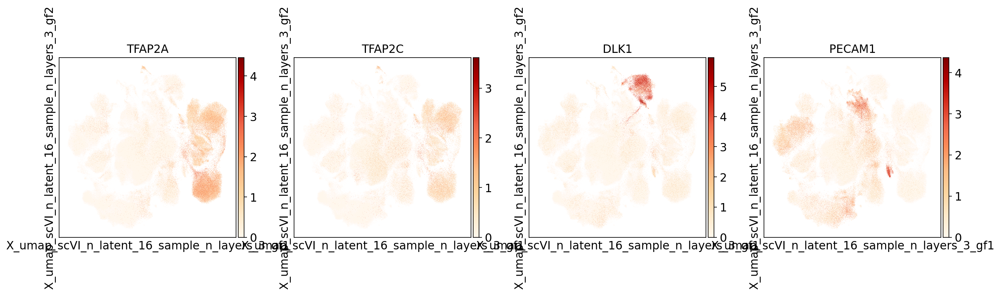

In [51]:
# all troph markers
sc.pl.embedding(adata, curr_embedding_key, color=['TFAP2A','TFAP2C',
                                                 'DLK1', # fF?
                                                  'PECAM1', # Endo compartment
                                                 ],
               cmap='OrRd', use_raw=True,
               )

In [ ]:
# produce bar plots to help coarse cluster annotation

In [24]:
df_stats = pd.DataFrame(columns=list(np.unique(adata.obs['celltype_predictions'])),
                     index=list(np.unique(adata.obs['louvain_scVI_n_latent_16_sample_n_layers_3_gf'])))

In [25]:
df_stats

,0_dS1,10_Tcells,11_dNK3,12_F1,13_EVT,14.1_PV1,14.2_PV2,15_Tcells,16_EVT,17_NK,...,31_NK CD16,32_ILC3,33_F2,3_dS2,4_Tcells,5_dNK1,6_dM2,7_dM1,8_Tcells,9_VCT
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [26]:
for celltype in df_stats.columns:
    print('celltype', celltype)
    for cluster in df_stats.index:
        #print(cluster)
        df_stats.loc[cluster, celltype] = adata[(adata.obs['celltype_predictions'] == celltype)
                                         & (adata.obs['louvain_scVI_n_latent_16_sample_n_layers_3_gf'] == cluster)].X.shape[0]

celltype 0_dS1


/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


celltype 10_Tcells
celltype 11_dNK3
celltype 12_F1
celltype 13_EVT
celltype 14.1_PV1
celltype 14.2_PV2
celltype 15_Tcells
celltype 16_EVT
celltype 17_NK
celltype 18_HB
celltype 19.1_Endo (m)
celltype 19.2_Endo L
celltype 19.3_Endo (f)
celltype 1_VCT
celltype 20_SCT
celltype 21_dS3
celltype 22_M3
celltype 23_MO
celltype 24_dNKp
celltype 25.1_Epi1
celltype 25.2_Epi2
celltype 26_Plasma
celltype 27_DC1
celltype 29_MO
celltype 2_dNK2
celltype 30_Granulocytes
celltype 31_NK CD16
celltype 32_ILC3
celltype 33_F2
celltype 3_dS2
celltype 4_Tcells
celltype 5_dNK1
celltype 6_dM2
celltype 7_dM1
celltype 8_Tcells
celltype 9_VCT


In [27]:
df_stats

,0_dS1,10_Tcells,11_dNK3,12_F1,13_EVT,14.1_PV1,14.2_PV2,15_Tcells,16_EVT,17_NK,...,31_NK CD16,32_ILC3,33_F2,3_dS2,4_Tcells,5_dNK1,6_dM2,7_dM1,8_Tcells,9_VCT
0,18023,1,1,548,0,2769,2275,2,41,33,...,0,0,0,35371,0,3,94,645,46,2
1,1008,13,3,461,5,22,229,1,278,18,...,0,4,2,36233,0,116,490,1182,73,2
10,12,0,5,6,0,0,1,0,2,4,...,0,0,0,90,0,0,2738,3794,109,0
11,20,0,0,7446,4,8,19,0,34,0,...,0,0,4,3519,0,0,5,19,2,5
12,348,0,2,175,1,135,52,2,29,9,...,0,1,0,3446,0,22,106,119,27,2
13,1,0,0,0,0,0,2,0,0,0,...,0,0,0,9133,0,0,0,1,3,0
14,1,0,9,18,0,0,0,0,29,0,...,0,0,0,8,0,0,3107,338,1,6
15,65,8,12,1706,1,22,11,5,129,105,...,0,5,0,5340,0,261,328,294,7,0
16,0,0,10,320,48,1,0,0,196,54,...,0,0,0,590,1,12,7,194,4,4103
17,41,0,0,340,0,8,20,0,15,11,...,0,0,0,4338,0,0,31,82,1,0


In [28]:
df_stats_norm = df_stats.div(df_stats.sum(axis=1), axis=0)

In [32]:
sorted(df_stats.index)

['0',
 '1',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19',
 '2',
 '20',
 '21',
 '22',
 '23',
 '24',
 '25',
 '26',
 '27',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9']

In [45]:
cols_new_order = ['0_dS1',
                  '1_VCT','2_dNK2','3_dS2',
  '4_Tcells',
  '5_dNK1',
  '6_dM2',
  '7_dM1',
  '8_Tcells',
  '9_VCT',
  '10_Tcells',
  '11_dNK3',
  '12_F1',
  '13_EVT',
  '14.1_PV1',
  '14.2_PV2',
  '15_Tcells',
  '16_EVT',
  '17_NK',
  '18_HB',
  '19.1_Endo (m)',
  '19.2_Endo L',
  '19.3_Endo (f)',
  '20_SCT',
  '21_dS3',
  '22_M3',
  '23_MO',
  '24_dNKp',
  '25.1_Epi1',
  '25.2_Epi2',
  '26_Plasma',
  '27_DC1',
  '29_MO',
  '30_Granulocytes',
  '31_NK CD16',
  '32_ILC3',
  '33_F2',]
df_stats_norm = df_stats_norm[cols_new_order]
df_stats_norm

,0_dS1,1_VCT,2_dNK2,3_dS2,4_Tcells,5_dNK1,6_dM2,7_dM1,8_Tcells,9_VCT,...,24_dNKp,25.1_Epi1,25.2_Epi2,26_Plasma,27_DC1,29_MO,30_Granulocytes,31_NK CD16,32_ILC3,33_F2
0,0.289103,0.000096,0.000321,0.567379,0.0,0.000048,0.001508,0.010346,0.000738,0.000032,...,0.000032,0.007892,0.01179,0.000048,0.0,0.0,0.000369,0.0,0.0,0.0
1,0.018331,0.000509,0.002855,0.658902,0.0,0.002109,0.008911,0.021495,0.001328,0.000036,...,0.000055,0.137079,0.018494,0.000236,0.0002,0.0,0.003273,0.0,0.000073,0.000036
10,0.000905,0.000151,0.004451,0.00679,0.0,0.0,0.206564,0.286232,0.008223,0.0,...,0.0,0.006035,0.005658,0.000754,0.002942,0.000075,0.001433,0.0,0.0,0.0
11,0.001796,0.000269,0.00009,0.316059,0.0,0.0,0.000449,0.001706,0.00018,0.000449,...,0.0,0.000269,0.000269,0.0,0.0,0.0,0.001527,0.0,0.0,0.000359
12,0.031465,0.000452,0.000723,0.311573,0.0,0.001989,0.009584,0.010759,0.002441,0.000181,...,0.000814,0.014195,0.028933,0.0,0.00009,0.0,0.000181,0.0,0.00009,0.0
13,0.000105,0.0,0.0,0.954536,0.0,0.0,0.0,0.000105,0.000314,0.0,...,0.0,0.000105,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
14,0.000112,0.001898,0.000112,0.000893,0.0,0.0,0.346957,0.037744,0.000112,0.00067,...,0.000112,0.00536,0.025461,0.000112,0.0,0.0,0.00268,0.0,0.0,0.0
15,0.007541,0.001856,0.006148,0.61949,0.0,0.030278,0.038051,0.034107,0.000812,0.0,...,0.000116,0.008469,0.008237,0.000348,0.003248,0.0,0.002436,0.0,0.00058,0.0
16,0.0,0.202307,0.000417,0.081979,0.000139,0.001667,0.000973,0.026956,0.000556,0.570099,...,0.0,0.001806,0.002918,0.0,0.0,0.0,0.001945,0.0,0.0,0.0
17,0.00835,0.000407,0.0,0.883503,0.0,0.0,0.006314,0.016701,0.000204,0.0,...,0.000204,0.000815,0.002037,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [46]:
len(np.unique(adata.obs['celltype_predictions']))

37

In [47]:
np.unique(adata.obs['celltype_predictions'])

array(['0_dS1', '10_Tcells', '11_dNK3', '12_F1', '13_EVT', '14.1_PV1',
       '14.2_PV2', '15_Tcells', '16_EVT', '17_NK', '18_HB',
       '19.1_Endo (m)', '19.2_Endo L', '19.3_Endo (f)', '1_VCT', '20_SCT',
       '21_dS3', '22_M3', '23_MO', '24_dNKp', '25.1_Epi1', '25.2_Epi2',
       '26_Plasma', '27_DC1', '29_MO', '2_dNK2', '30_Granulocytes',
       '31_NK CD16', '32_ILC3', '33_F2', '3_dS2', '4_Tcells', '5_dNK1',
       '6_dM2', '7_dM1', '8_Tcells', '9_VCT'], dtype=object)

Text(0.5, 0, 'Cluster')

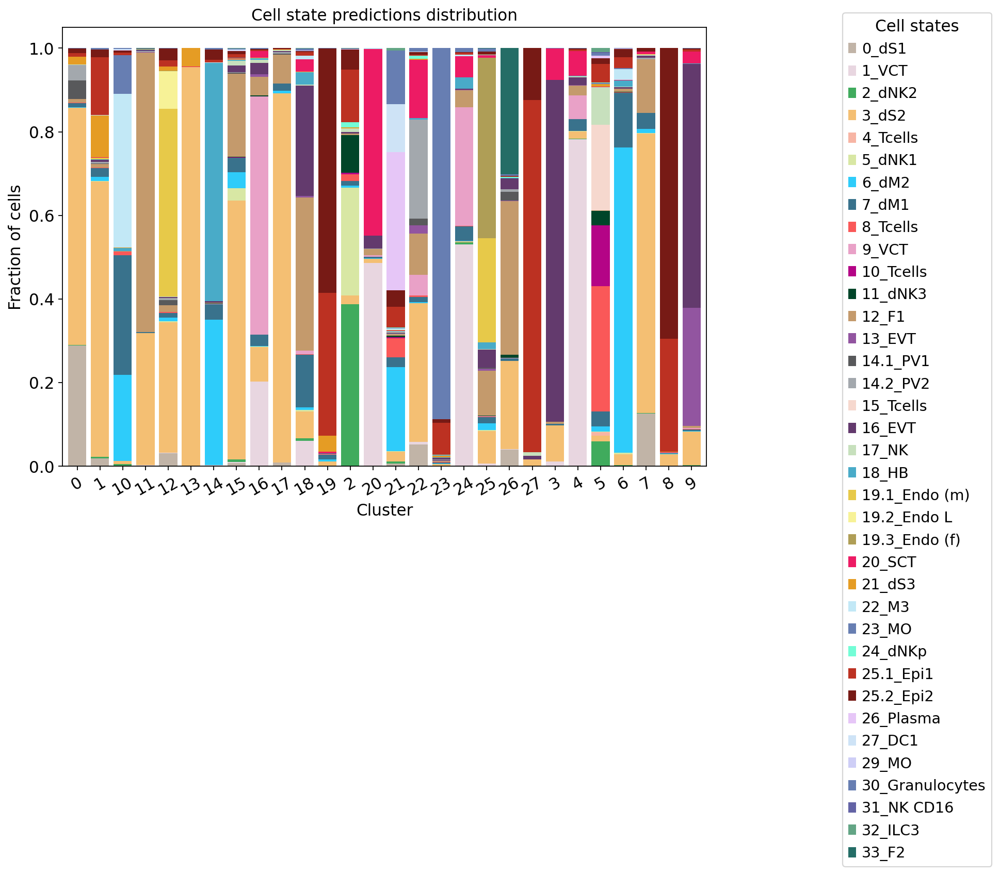

In [48]:
# this is for final cells only

ax = df_stats_norm.plot.bar(stacked=True, figsize=(10,7), width=0.8,
                           color = colors_VT)

handles, labels = ax.get_legend_handles_labels()

ax.legend(handles,
          labels, title='Cell states',
          bbox_to_anchor=(1.20, 1.05))

ax.set_xticklabels(labels=np.unique(adata.obs['louvain_scVI_n_latent_16_sample_n_layers_3_gf']))
ax.tick_params(axis='x', rotation=30)

# to turn off the grid
plt.grid(b=None)

plt.title('Cell state predictions distribution')
plt.ylabel('Fraction of cells')
plt.xlabel('Cluster')

#plt.savefig('./figures/20211025_cell_state_distr_vs_donor_no_cyt.pdf',
#           bbox_inches='tight')

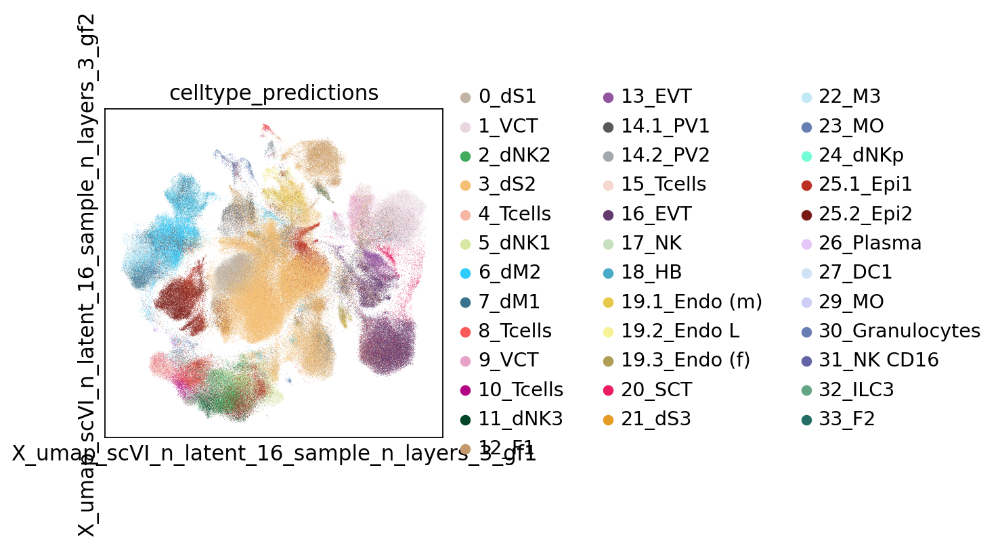

In [49]:
sc.pl.embedding(adata, curr_embedding_key, color=['celltype_predictions'],
               ncols=1
               )

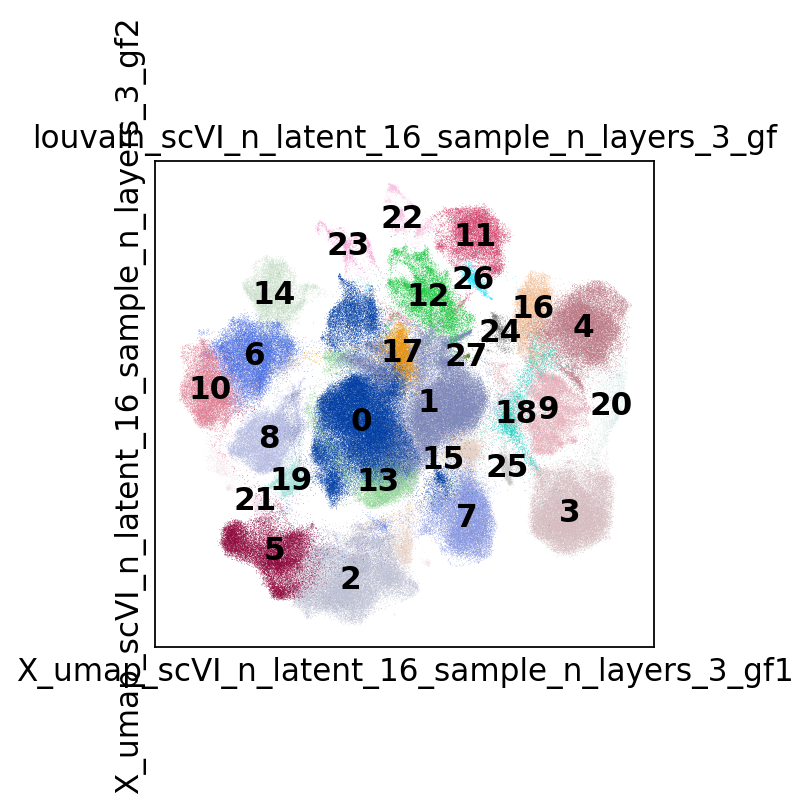

In [18]:
sc.pl.embedding(adata, curr_embedding_key, color=['louvain_scVI_n_latent_16_sample_n_layers_3_gf',
                                                 #'celltype_predictions','annotations_P13_troph','donor','technology'
                                                 ], legend_loc='on data',
               ncols=1
               )

# Performing annotation into coarse compartments

In [52]:
def annot_coarse(adata_obj, barcode_sample):
    
    curr_cluster = adata.obs.loc[barcode_sample, 'louvain_scVI_n_latent_16_sample_n_layers_3_gf']
    
    if curr_cluster in ['16','18','20','24','3','4','9']:
        return('Trophoblast')
    elif curr_cluster in ['0','1','13','15','17','7']:
        return('dS_uSMC')
    elif curr_cluster == '22':
        return('PV')
    elif curr_cluster in ['19','27','8']:
        return('Epithelial')
    elif curr_cluster in ['19','27','8']:
        return('Epithelial')
    elif curr_cluster == '2':
        return('NK')
    elif curr_cluster == '5':
        return('T')
    elif curr_cluster in ['10','14','21','23','6']:
        return('Myeloid')
    elif curr_cluster in ['12','25']:
        return('Endothelial')
    elif curr_cluster in ['11','26']:
        return('fF')
    
    else:
        return('none')
    

In [54]:
adata.obs['annot_coarse'] = adata.obs['barcode_sample_copy'].apply(lambda x: annot_coarse(adata, x))

... storing 'annot_coarse' as categorical


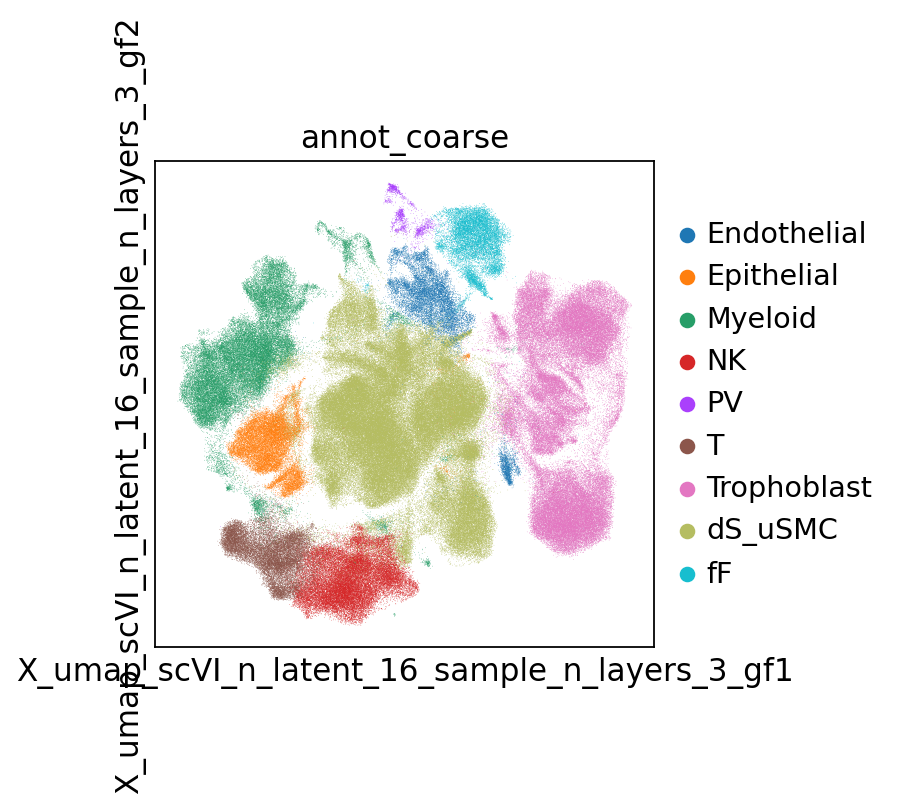

In [55]:
sc.pl.embedding(adata, curr_embedding_key, color=['annot_coarse'], #legend_loc='on data',
               ncols=1
               )

In [56]:
# save coarse annotation to use for data subsetting
adata.obs.to_csv(save_path + 'obs_table_with_coarse_annot_from_M4_notebook_all_cell_states.csv')

#### From here following to notebook S0-1 to analyse trophoblast compartment